# Homework 1

In this assignment, we will be exploring the car dataset and analyzing their fuel efficiency. <br >
Specifically, we will do some exploratory analysis with visualizations, then we will build a model for Simple Linear Regression, a model for Polynomial Regression, and one model for Logistic Regression. <br >
**The given dataset is already modified and cleaned**, but you can find [the original information here.](https://archive.ics.uci.edu/ml/datasets/auto+mpg).

## Dataset Attribute Information

1. **mpg**: Miles per gallon. This is one primary measurement for car fuel efficiency.
2. **displacement** : The cylinder volumes in cubic inches.
3. **horsepower** : Engine power.
4. **weight** : In pounds.
5. **acceleration** : The elapsed time in seconds to go from 0 to 60mph.
6. **origin** : Region of origin.

### Libraries that can be used: numpy, pandas, scikit-learn, seaborn, plotly, matplotlib
Any libraries used in the discussion materials are also allowed.

#### Other Notes
 - Don't worry about not being able to achieve high accuracy, it is neither the goal nor the grading standard of **this** assignment. <br >
 - If not specified, you are not required to do hyperparameter tuning, but feel free to do so if you'd like.
 - Discussion materials should be helpful for doing the assignments.

# Exercises
## Exercise 1 - Exploratory Analysis (20 points in total)

### Exercise 1.1 - Correlation Matrix (10 points)
Generate a Pearson [correlation matrix plot](https://heartbeat.fritz.ai/seaborn-heatmaps-13-ways-to-customize-correlation-matrix-visualizations-f1c49c816f07) in the form of a heatmap. See the link to have an idea about what this visualization should look like. <br >
After generating the plot, answer the following question: <br >
**If we are going to predict ``mpg`` in Simple Linear Regression(i.e., $y=ax+b$), which attribute are you most UNLIKELY to pick as the independent variable? Explain why.**

Requirements & notes
 - When computing correlation, make sure to drop the column ``origin`` to avoid errors.
 - The computed correlation values should be shown on the plot.
 - Use a diverging color scale with the color range being \[-1, 1\] and center being 0 (if applicable).

### Exercise 1.2 - Pairplot (10 points)
Generate a pairplot(a.k.a. scatter plot matrix) of the given dataset. <br >
After generating the plot, answer the following question: <br >
**If we are using ``horsepower`` to predict ``mpg``, which method could lead to the best performance? (Linear Regression, Polynomial Regression, or Logistic Regression) Explain why.**

Note that there is no requirement on the diagonals. You can leave empty or use other representations based on your preference. However, having ``origin``-based grouped data distributions on the diagonals effectively helps you answer some questions in the later exercises.   

Requirements
 - The points should be colored based on the column ``origin``.

## Exercise 2 - Linear and Polynomial Regression (40 points in total)

### Exercise 2.1 - Splitting Dataset (5 points)
Split the data into training and testing set with the ratio of 80:20.

### Exercise 2.2 - Simple Linear Regression (10 points)
Using one of the other attributes(excluding ``origin``) by your choice, please build a simple linear regression model that predicts ``mpg``. <br >

Requirements
 - Report the testing MSE error.

### Exercise 2.3 - Polynomial Regression (25 points)
Build polynomial regression models that predict ``mpg`` with the same choice in 2.2. <br >
Specifically, from degree=2 to degree=4, build one respectively. <br >
Then, based on the reported errors from only these three degrees, **do you think there is a sign of overfitting? Provide your reasoning.**


Requirements
 - Report the training MSE error for each of the three degrees.
 - Report the testing MSE error for each of the three degrees.


## Exercise 3 - Logistic Regression (40 points in total)

Now we are going to build a classification model on ``origin`` using all the other 5 attributes. <br >
Note that Logistic Regression is a binary classificaiton algorithm.

### Exercise 3.1 - Processing and Splitting the Dataset (10 points)
In this exercise 3, we only consider those observations where they originate from either "USA" or "Japan". <br >
So please **remove** those observations that originate from "Europe". <br >
And then, split the data into training and testing set with the ratio of 80:20. <br >


### Exercise 3.2 - Logistic Regression (30 points)

Using all the other 5 attributes, please build a Logistic Regression model that distinguishes between cars from Japan and cars from the USA. <br >
Then, **if we are distinguishing between Japan and Europe this time, how do you think the model performance(in terms of accuracy) will change? Provide your reasoning.** (Hint: Exercise 1)

Requirements
 - Report the testing precision and recall for both regions.

In [ ]:
# one hot encode Education, Martial_Status, and 

import seaborn as sns
import matplotlib as plt
import numpy as np
import pandas as pd

df = pd.read_csv("marketing_campaign_exported.csv")

print('hello')
_ = sns.pairplot(df, hue='class')
#_.fig.set_size_inches(15,15)
print('hello')

In [1]:
import seaborn as sns
import matplotlib as plt
import numpy as np
import pandas as pd


df = pd.read_csv("marketing_campaign_exported.csv")


print(df)

         ID  Year_Birth   Education Marital_Status   Income  Kidhome  \
0      5524        1957  Graduation         Single  58138.0        0   
1      2174        1954  Graduation         Single  46344.0        1   
2      4141        1965  Graduation       Together  71613.0        0   
3      6182        1984  Graduation       Together  26646.0        1   
4      5324        1981         PhD        Married  58293.0        1   
...     ...         ...         ...            ...      ...      ...   
2235  10870        1967  Graduation        Married  61223.0        0   
2236   4001        1946         PhD       Together  64014.0        2   
2237   7270        1981  Graduation       Divorced  56981.0        0   
2238   8235        1956      Master       Together  69245.0        0   
2239   9405        1954         PhD        Married  52869.0        1   

      Teenhome Dt_Customer  Recency  MntWines  ...  NumWebVisitsMonth  \
0            0  04-09-2012       58       635  ...            

In [2]:
import seaborn as sns
import matplotlib as plt
import numpy as np
import pandas as pd
from sklearn.preprocessing import LabelEncoder 
from sklearn.preprocessing import OneHotEncoder

df = pd.read_csv("marketing_campaign_exported.csv")

# Do Binary Encoding for the Education and Martial Status classes

labels = df["Education"]
#print(labels)
myData_encoder = LabelEncoder()
labels_encoded =  myData_encoder.fit_transform(labels)


# binary encode
onehot_encoder = OneHotEncoder(sparse=False) # disable sparse return type
# reshape the array
labels_encoded = labels_encoded.reshape(len(labels_encoded), 1) 
onehot_encoded = onehot_encoder.fit_transform(labels_encoded)

df["Education"] = pd.Series(onehot_encoded.tolist())

labels = df["Marital_Status"]
#print(labels)
myData_encoder = LabelEncoder()
labels_encoded =  myData_encoder.fit_transform(labels)

# binary encode
onehot_encoder = OneHotEncoder(sparse=False) # disable sparse return type
# reshape the array
labels_encoded = labels_encoded.reshape(len(labels_encoded), 1) 
onehot_encoded = onehot_encoder.fit_transform(labels_encoded)

df["Marital_Status"] = pd.Series(onehot_encoded.tolist())

# Income column contains NA, drop them
df.dropna(subset = ["Income"],inplace=True)


# Drop the day and months, and keep the years
# Then one hot encode the years

df[["Day","Month","Year"]] = df["Dt_Customer"].str.split("-",expand=True)
df = df.drop(columns=["Dt_Customer","Day"])

print(df[0:15])

df.to_csv("Cleaned_dataset_Group1.csv")

      ID  Year_Birth                  Education  \
0   5524        1957  [0.0, 0.0, 1.0, 0.0, 0.0]   
1   2174        1954  [0.0, 0.0, 1.0, 0.0, 0.0]   
2   4141        1965  [0.0, 0.0, 1.0, 0.0, 0.0]   
3   6182        1984  [0.0, 0.0, 1.0, 0.0, 0.0]   
4   5324        1981  [0.0, 0.0, 0.0, 0.0, 1.0]   
5   7446        1967  [0.0, 0.0, 0.0, 1.0, 0.0]   
6    965        1971  [0.0, 0.0, 1.0, 0.0, 0.0]   
7   6177        1985  [0.0, 0.0, 0.0, 0.0, 1.0]   
8   4855        1974  [0.0, 0.0, 0.0, 0.0, 1.0]   
9   5899        1950  [0.0, 0.0, 0.0, 0.0, 1.0]   
11   387        1976  [0.0, 1.0, 0.0, 0.0, 0.0]   
12  2125        1959  [0.0, 0.0, 1.0, 0.0, 0.0]   
13  8180        1952  [0.0, 0.0, 0.0, 1.0, 0.0]   
14  2569        1987  [0.0, 0.0, 1.0, 0.0, 0.0]   
15  2114        1946  [0.0, 0.0, 0.0, 0.0, 1.0]   

                              Marital_Status   Income  Kidhome  Teenhome  \
0   [0.0, 0.0, 0.0, 0.0, 1.0, 0.0, 0.0, 0.0]  58138.0        0         0   
1   [0.0, 0.0, 0.0, 0.0, 1.0, 0


Testing RMSE: 4.665935350427151


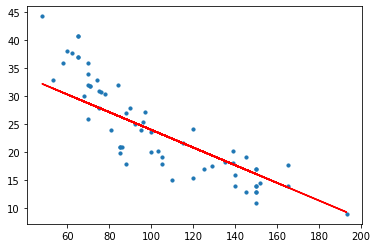

In [3]:
# Exercise 2.2
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import numpy as np

"""
x_train = training[["horsepower"]].to_numpy()
y_train = training[["mpg"]].to_numpy()

x_test = testing[["horsepower"]].to_numpy()
y_test = testing[["mpg"]].to_numpy()"""
x_train, x_test, y_train, y_test = train_test_split(training[["horsepower"]].to_numpy(),
                                                    training[["mpg"]].to_numpy(),
                                                    test_size=0.20, random_state=0)


model = LinearRegression()
model.fit(x_train,y_train) # Build model using training

#here, we call predict on the training set because we want to see the fit of the model on the training set. 
#y_train_pred = model.predict(x_train)
y_test_pred = model.predict(x_test)

rmse = np.sqrt(mean_squared_error(y_test,y_test_pred))
print('\nTesting RMSE: %8.15f' % rmse)

plt.scatter(x_test, y_test, s=10)
plt.plot(x_test, y_test_pred, color='r')
plt.show()



Degree 2 Training RMSE: 3.606590994627662

Degree 2 Test RMSE: 7.296576592702894

Degree 3 Training RMSE: 3.604241198667423

Degree 3 Test RMSE: 7.283003030712062

Degree 4 Training RMSE: 3.594573919129742

Degree 4 Test RMSE: 7.269217421229982


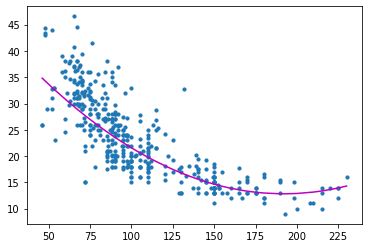

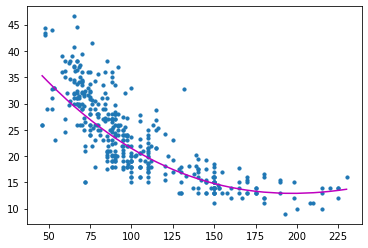

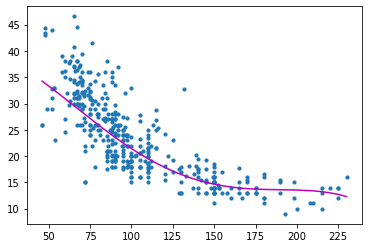

"\nAll 3 polynomial models have very similar performance, with \ndegree 4 performing the best with lowest testing RMSE.\nThey all have testing RMSE being somewhat higher than training RMSE,\nhowever, the difference (depending on one's tolerance) may not be \nlarge enough to consider as overfitting\n"

In [19]:
# Exercise 2.3
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.preprocessing import PolynomialFeatures
import numpy as np
import operator

df = pd.read_csv("auto-mpg.csv")

x = df["horsepower"].to_numpy()
y = df["mpg"].to_numpy()


x = x[:, np.newaxis]
y = y[:, np.newaxis]

for poly_degree in range(2,5):
    polynomial_features= PolynomialFeatures(degree=poly_degree)
    
    x_poly = polynomial_features.fit_transform(x)
    
    x_poly_train, x_poly_test, y_train, y_test = train_test_split(x_poly,y,
                                                    test_size=0.20, random_state=0,shuffle=False)
    
    model = LinearRegression()
    model.fit(x_poly_train, y_train)
    y_train_pred = model.predict(x_poly_train)
    y_test_pred = model.predict(x_poly_test)
    
    rmse_train = np.sqrt(mean_squared_error(y_train,y_train_pred))
    rmse_test = np.sqrt(mean_squared_error(y_test,y_test_pred))

    print('\nDegree ' + str(poly_degree) + ' Training RMSE: %8.15f' % rmse_train)
    print('\nDegree ' + str(poly_degree) +' Test RMSE: %8.15f' % rmse_test)

    plt.figure()
    plt.scatter(x, y, s=10)
    # sort the values of x before line plot
    sort_axis = operator.itemgetter(0)
    sorted_zip = sorted(zip(x,y_train_pred), key=sort_axis)
    x_poly_train, y_train_pred = zip(*sorted_zip)
    plt.plot(x_poly_train, y_train_pred, color='m')
plt.show()

"""
All 3 polynomial models have very similar performance, with 
degree 4 performing the best with lowest testing RMSE.
They all have testing RMSE being quite higher than training RMSE,
however, the difference (depending on one's tolerance) may not be 
large enough to consider as overfitting. I would consider it as overfitting,
but it depends.
"""


In [24]:
# Exercise 3.1
import seaborn as sns
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv("auto-mpg.csv")

df = df[df.origin != "Europe"]
#print(df[0:30])


x = df["horsepower"].to_numpy()
y = df["mpg"].to_numpy()

x_train, x_test, y_train, y_test = train_test_split(x,y,
                                            test_size=0.20, random_state=0,shuffle=False)

print(x)
print(y)


[130. 165. 150. 150. 140. 198. 220. 215. 225. 190. 170. 160. 150. 225.
  95.  95.  97.  85.  88.  90. 215. 200. 210. 193.  88.  90.  95. 100.
 105. 100.  88. 100. 165. 175. 153. 150. 180. 170. 175. 110.  72. 100.
  88.  86.  65.  69.  70.  95.  80.  90.  86. 165. 175. 150. 153. 150.
 208. 155. 160. 190.  97. 150. 130. 140. 150.  86.  92.  97.  80.  88.
 175. 150. 145. 137. 150. 198. 150. 158. 150. 215. 225. 175. 105. 100.
 100.  88.  95. 150. 167. 170. 180. 100.  88.  72.  94.  90.  85. 107.
 145. 230. 150. 122. 180.  95. 100. 100.  67.  80.  65.  75. 100. 110.
 105. 140. 150. 150. 140. 150.  52.  61.  75.  97.  93.  95. 105.  72.
  72. 170. 145. 150. 148. 110. 105. 110.  95. 110. 110. 129.  75.  83.
 100.  78.  96.  97.  97.  90.  53.  92.  79. 140. 150. 120. 152. 100.
 105.  81.  90.  52.  60.  53. 100.  78. 110.  95.  70.  75.  72. 150.
 108. 180. 145. 130. 150.  68.  80.  96.  70. 145. 110. 145. 130. 110.
 105. 100.  98. 180. 170. 190. 149.  88.  75.  89.  63.  83.  67.  97.
 110. 

In [23]:
# Exercise 3.2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix

df = pd.read_csv("auto-mpg.csv")
#print(df)

df = df[df.origin != "Europe"]
#print(df)

# Replace USA with 0, Japan with 1
df["origin"][df.origin == "USA"] = 0
df["origin"][df.origin == "Japan"] = 1

x = df[["mpg","displacement","horsepower","weight","acceleration"]].to_numpy()
y = df["origin"].to_numpy()
# https://stackoverflow.com/questions/45346550/valueerror-unknown-label-type-unknown
y = y.astype('int') # y array is of type objects

x_train, x_test, y_train, y_test = train_test_split(x,y,
                                            test_size=0.20, random_state=0,shuffle=False)


model = LogisticRegression(multi_class="multinomial").fit(x_train,y_train)

# [true negatives, false positive]
# [false negatives, true positives]
c_matrix = confusion_matrix(y_test, model.predict(x_test))
print(c_matrix)
# precision = true positives / (true positives + false positives)
precision = c_matrix[1][1]/(c_matrix[1][1] + c_matrix[0][1])
# recall = true positives / (true positives + false negatives)
recall = c_matrix[1][1]/(c_matrix[1][1] + c_matrix[1][0])

print("Testing set precision is: ", precision)
print("Testing set recall is: ", recall)

"""
If the data is changed to between Japan and Europe, I believe the 
accuracy of the model will decrease. Looking at the pairplots, its easier 
to distinguish between USA and the other two, since the USA has lower mpg
"""

[[25  8]
 [11 21]]
Testing set precision is:  0.7241379310344828
Testing set recall is:  0.65625


<ipython-input-23-49932b0400b3>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["origin"][df.origin == "Japan"] = 1


'\nIf the data is changed to between Japan and Europe, I believe the \naccuracy of the model will decrease. Looking at the pairplots, its easier \nto distinguish between USA and the other two, since the USA has lower mpg\n'

<AxesSubplot:>

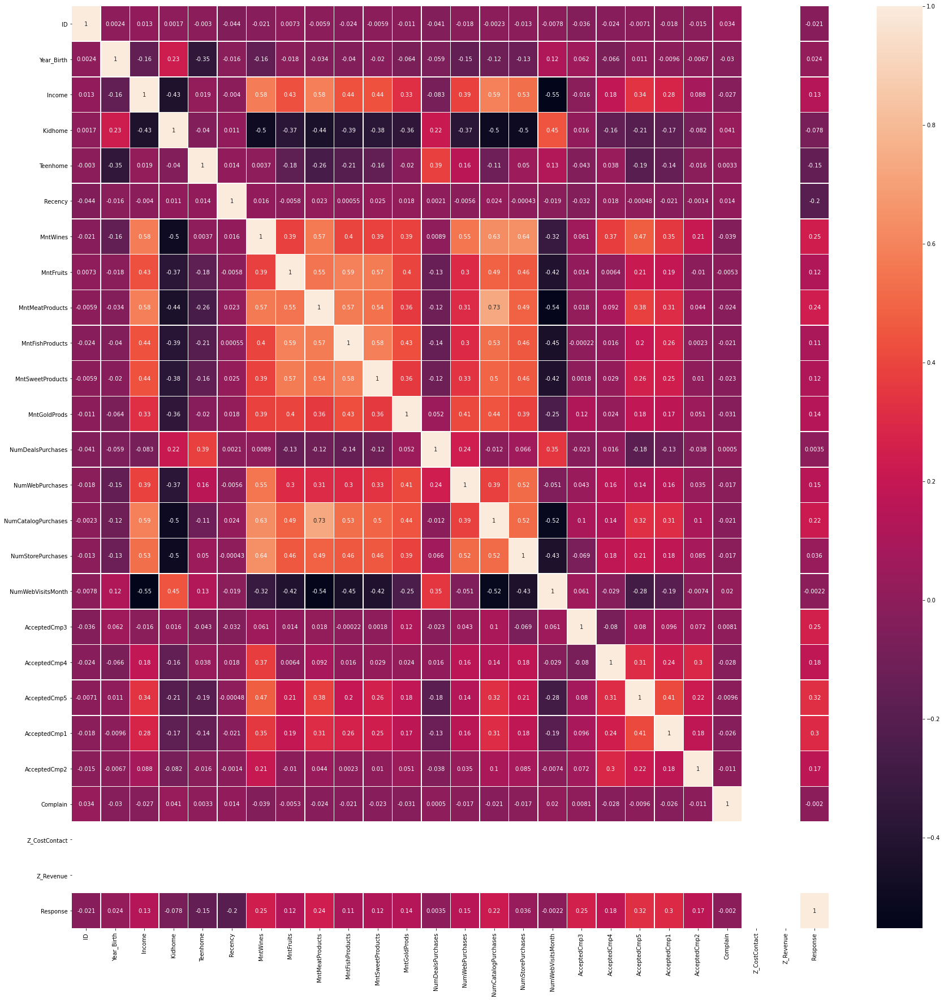

In [17]:
import seaborn as sb
import matplotlib.pyplot as plt

fig, ax = plt.subplots(figsize=(30,30))
sns.heatmap(df.corr(), annot=True, linewidths=.5, ax=ax)

In [18]:
data = df.copy()
data.style.set_precision(3).background_gradient(cmap='RdBu', vmin=-1, vmax=1)

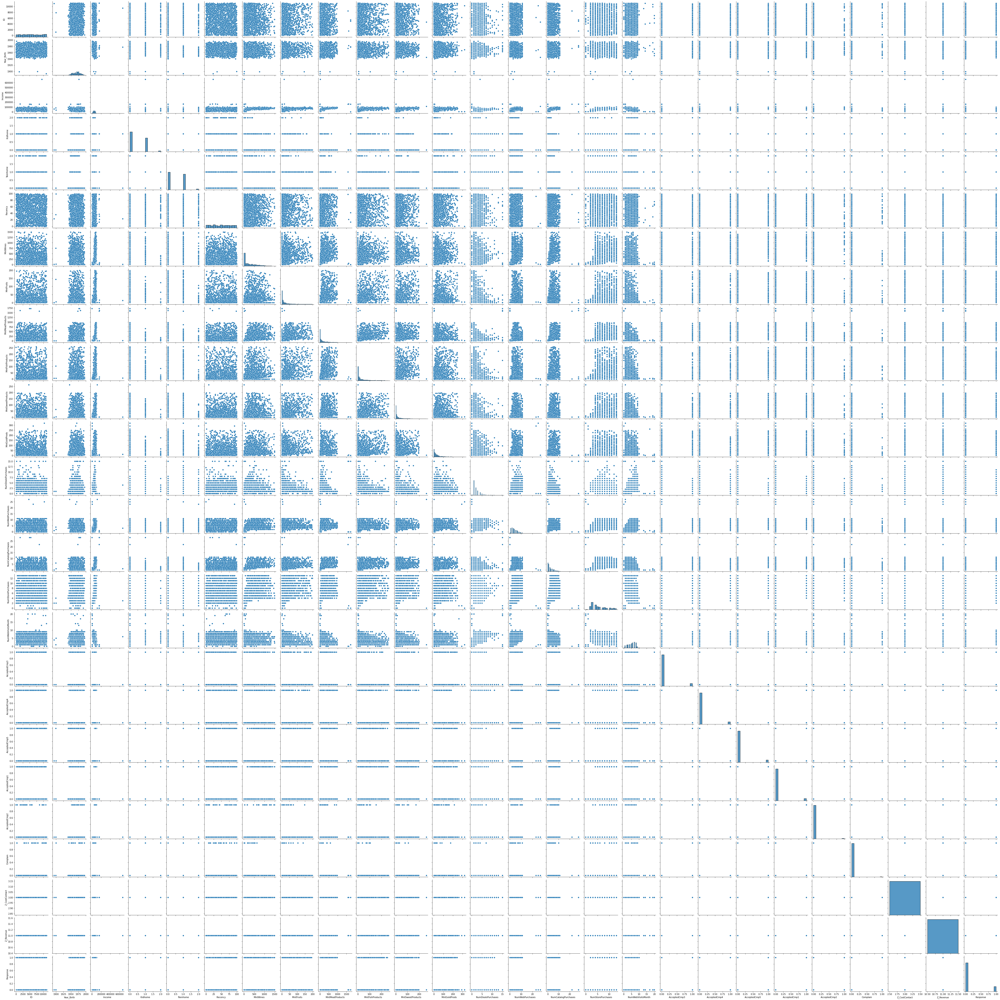

In [3]:
import seaborn as sb
sb.pairplot(df)

In [7]:

sns.pairplot(df, height=5)

In [8]:
import matplotlib.ticker as mticker
### Pandas solution
data = df
# Create customized colormaps, the same as above.
colors, codes = pd.factorize(df['origin'])
cmap = matplotlib.colors.LinearSegmentedColormap.from_list("tab", ['tab:blue',"tab:orange","tab:green"])

axs = pd.plotting.scatter_matrix(df, c=colors, diagonal='hist', cmap=cmap, figsize=(10, 10))

#### Technically, you can stop here, even though the histograms are for the whole data.

# If you want to fix visualizations on the diagonals, we have to wipe them first.
# Note that because this is from pandas interface, so setting up colormaps and legends is different and relatively easier. (Pandas already took care of most work)
# However, most of the time here, I am fixing the axes because of Pandas being too high-level as well.
for i in range(0, data.shape[1]):
    # This is for setting the finalied axes correctly.
    if i == 0: # mpg corner
        ticks = axs[i, i].get_yticks()
        ticklabels = axs[i, i].get_yticklabels()
        
    #### Actual fixing visualizations part.
    axs[i, i].clear() # Clean all the plotting objects in this subplot
    attrib = data.columns[i]
    for label, group in df.loc[:, [attrib, 'origin']].groupby('origin'):
        group.plot(kind="kde", ax=axs[i,i], legend=False, alpha=0.5)
    
    # The following is all for fixing axes.
    handles, _ = axs[i, i].get_legend_handles_labels()
        
    if i == 0: # mpg corner 
        # The reason why this is a huge chunk: 
        # I have to change the axis labels without touching the axis ticks. 
        # Because once I touched the ticks, this plot will be compressed and show something wrong.
        updated_labels = axs[i, i].get_yticklabels()
        for original, update in zip(ticklabels, updated_labels[1:-1]):
            update.set_text(original.get_text()) # Update the text labels
    
        # Make sure we are fixating the ticks first, then setting the ticklabels next.
        # In Matplotlib, you always have to update both ticks and ticklabels to avoid any warnings.
        ticks_loc = axs[i, i].get_yticks().tolist()
        axs[i, i].yaxis.set_major_locator(mticker.FixedLocator(ticks_loc))
        axs[i, i].set_yticklabels(updated_labels)
    else:
        axs[i, i].set_yticks([])
    
    # Setting the attribute labels
    axs[i, i].set_ylabel('')
    if i == data.shape[1]-1: axs[i, i].set_xlabel(attrib)
    if i == 0:  axs[i, i].set_ylabel(attrib)

# The bbox_to_anchor here is a very ugly fix, please don't follow this :)
_ = plt.legend(handles, ['USA', 'Japan', 'Europe'], loc='center right', bbox_to_anchor=(1.75, 2.5))

KeyError: 'origin'